# Projeto de Insights - King Count Houses <a class="tocSkip">

## Imports

In [1]:
import pandas as pd
import datetime as dt
import numpy as np
from matplotlib import pyplot as plt

from pandas_profiling import ProfileReport
import cufflinks as cf
cf.go_offline()

In [2]:
from IPython.core.display  import HTML
import seaborn as sns
def jupyter_settings():
    %matplotlib inline
    %pylab inline
    plt.style.use( 'bmh' )
    plt.rcParams['figure.figsize'] = [20, 10]
    plt.rcParams['font.size'] = 24
    display( HTML( '<style>.container { width:100% !important; }</style>') )
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option( 'display.expand_frame_repr', False )
    sns.set()
jupyter_settings()

Populating the interactive namespace from numpy and matplotlib


## Data Collect

In [3]:
data = pd.read_csv('../Datasets/kc_house_data.csv')

In [4]:
display(data.sample(5))

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
12841,263000325,20140611T000000,349000.0,3,2.50,1430,1002,3.0,0,0,3,8,1430,0,2002,0,98103,47.6980,-122.349,1430,1530
6662,5379802181,20141119T000000,193000.0,2,1.00,680,8640,1.0,0,0,4,5,680,0,1951,0,98188,47.4559,-122.289,1320,13140
15592,5093300280,20140709T000000,1681000.0,5,5.25,4830,18707,2.0,0,1,5,9,3930,900,1952,1998,98040,47.5858,-122.247,2880,10520
17639,1023089197,20141007T000000,390000.0,3,2.00,1930,12443,1.0,0,0,3,7,1930,0,1969,0,98045,47.4906,-121.775,1400,12183
16972,7784400185,20150421T000000,499000.0,3,1.75,2650,11774,1.0,0,1,3,8,2240,410,1952,0,98146,47.4909,-122.363,2650,10120


## Data Description

In [5]:
dimensionData = data.shape
print(f'This dataset has {dimensionData[0]} properties and {dimensionData[1]} available attributes.')

This dataset has 21613 properties and 21 available attributes.


In [6]:
print('The dataset columns is: [', end= '')
dataFrameColumns = list(data.columns)
for index, columns in enumerate(dataFrameColumns):
    print(f'{columns}', end= '')
    if index == (len(dataFrameColumns) - 1):
        print(end= '.')
        print(']')
    else:
        print(end= ', ')


The dataset columns is: [id, date, price, bedrooms, bathrooms, sqft_living, sqft_lot, floors, waterfront, view, condition, grade, sqft_above, sqft_basement, yr_built, yr_renovated, zipcode, lat, long, sqft_living15, sqft_lot15.]


In [7]:
data.info()
#This dataset has no null values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [8]:
#Note 1: What is the relevance of some columns in this analysis?
#Columns to watch: 'view', 'grade', 'sqft_living15', 'sqft_lot15'
#Identify, transform or delete; 

#Note 2: Transform the attribute type 'date' and verify its compliance; 

#Note 3: It's necessary transforming 'condition' and 'waterview' in object type for response business questions 

## Data Cleaning and Data Tranformation

### Note 1

In [9]:
#view
data['view'].unique()

#Analyze: Scale how good the view is.
#Decision: Transform column type to object with classifications
# 0 and 1 - bad 
# 2 - regular
# 3 and 4 - good

array([0, 3, 4, 2, 1])

In [10]:
data['view'] = data['view'].apply(lambda x: 'bad' if x < 2 else 'regular' if x == 2 else 'good')
data['view'].unique()

array(['bad', 'good', 'regular'], dtype=object)

In [11]:
#grade
data['grade'].unique()

#It's an index from 1 to 13, where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design.
#Defcision - Change the attribute 'grade' to low_quality_design, average_quality_design and high_quality_design                    

array([ 7,  6,  8, 11,  9,  5, 10, 12,  4,  3, 13,  1])

In [12]:
data['grade'] = data['grade'].apply (lambda x:   'high_quality_design' if x >= 11 else 
                                                'avg_quality_design' if (x > 3) & (x <= 10) else
                                                'low_quality_design')                     
data['grade'].unique()

array(['avg_quality_design', 'high_quality_design', 'low_quality_design'],
      dtype=object)

In [13]:
#Deleting unnecessary columns
#sqft_living15 - The square footage of interior housing living space for the nearest 15 neighbors; unnecessary
#sqft_lot15 - The square footage of the land lots of the nearest 15 neighbors; unnecessary

data = data.drop(['sqft_living15' , 'sqft_lot15'], axis= 1)

In [14]:
print(f'Now, this dataset has {data.shape[1]} attributes')

Now, this dataset has 19 attributes


In [15]:
#Checking Duplicates values
#display(data[data['id'].duplicated(keep= False)])
dataframe = data[data[['id', 'price']].duplicated(keep= False)]
display(dataframe)

#There are two types of duplicate data:
#os with same id but different prices(updated);
#and those with the same id and the same price;
#The most outdated types in relation to the date will be eliminated

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long
3950,1825069031,20140814T000000,550000.0,4,1.75,2410,8447,2.0,0,good,4,avg_quality_design,2060,350,1936,1980,98074,47.6499,-122.088
3951,1825069031,20141016T000000,550000.0,4,1.75,2410,8447,2.0,0,good,4,avg_quality_design,2060,350,1936,1980,98074,47.6499,-122.088
14982,6308000010,20141208T000000,585000.0,3,2.50,2290,5089,2.0,0,bad,3,avg_quality_design,2290,0,2001,0,98006,47.5443,-122.172
14983,6308000010,20150423T000000,585000.0,3,2.50,2290,5089,2.0,0,bad,3,avg_quality_design,2290,0,2001,0,98006,47.5443,-122.172
20053,8648900110,20140505T000000,555000.0,3,2.50,1940,3211,2.0,0,bad,3,avg_quality_design,1940,0,2009,0,98027,47.5644,-122.093
20054,8648900110,20140826T000000,555000.0,3,2.50,1940,3211,2.0,0,bad,3,avg_quality_design,1940,0,2009,0,98027,47.5644,-122.093


In [16]:
#The rows with duplicate values that have the parameter 'keep' equal to 'first' are the most up-to-date data
#So these rows will remain.

In [17]:
#Deleting duplicates values
data = data.drop_duplicates(subset= ['id', 'price'], keep= 'first')
data = data.drop_duplicates(subset= ['id'], keep= 'first')

display(data[data[['id', 'price']].duplicated(keep= False)])
display(data[data['id'].duplicated(keep= False)])

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long


In [18]:
#Reseting Index
data.reset_index(drop= True, inplace= True)

In [19]:
print(f'Now, this dataset has {data.shape[0]} registered properties')

Now, this dataset has 21436 registered properties


### Note 2

In [20]:
#Transforming date format for datetime
data['date'] = pd.to_datetime(data['date'], format= '%Y-%m-%d', errors= 'ignore')

In [21]:
#Separing and transforming date format to int
data['year'] = data['date'].dt.strftime('%Y')
data['year'] = data['year'].astype(int)

data['month'] = data['date'].dt.strftime('%m')
data['month'] = data['month'].astype(int)

data['days'] = data['date'].dt.strftime('%d')
data['days'] = data['days'].astype(int)


In [22]:
print(f'Now, this dataset has {data.shape[1]} attributes')

Now, this dataset has 22 attributes


In [23]:
data.columns.tolist()

['id',
 'date',
 'price',
 'bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'floors',
 'waterfront',
 'view',
 'condition',
 'grade',
 'sqft_above',
 'sqft_basement',
 'yr_built',
 'yr_renovated',
 'zipcode',
 'lat',
 'long',
 'year',
 'month',
 'days']

In [24]:
#Checking attribute compliance
describeDate = data[['year', 'month', 'days']].describe()
display(describeDate)
print('> YEAR')
print('The maximum year of property registration is {}'.format(data['year'].max()))
print('The minimum year of property registration is {}'.format(data['year'].min()))
print('> MONTH')
print('The maximum month of property registration is {}'.format(data['month'].max()))
print('The minimum month of property registration is {}'.format(data['month'].min()))
print('> DAYS')
print('The maximum days of property registration is {}'.format(data['days'].max()))
print('The minimum days of property registration is {}'.format(data['days'].min()))


,year,month,days
count,21436.000000,21436.000000,21436.000000
mean,2014.318949,6.590782,15.683476
std,0.466080,3.108176,8.636763
min,2014.000000,1.000000,1.000000
25%,2014.000000,4.000000,8.000000
50%,2014.000000,6.000000,16.000000
75%,2015.000000,9.000000,23.000000
max,2015.000000,12.000000,31.000000


> YEAR
The maximum year of property registration is 2015
The minimum year of property registration is 2014
> MONTH
The maximum month of property registration is 12
The minimum month of property registration is 1
> DAYS
The maximum days of property registration is 31
The minimum days of property registration is 1


In [25]:
#The date conforms to reality.

### Note 3

In [26]:
#Turning numerics atrribute into object attributes

In [27]:
#condition
# - If the value of the column "condition" is less than or equal to 2 > 'bad'
# - If the value of the column "condition" is equal to 3 or 4 > 'regular'
# - If the value of the column "condition" is equal to 5 > 'good'

data.loc[data['condition'] <= 2, 'condition'] = 'bad'
data.loc[(data['condition'] == 3) | (data['condition'] == 4), 'condition'] = 'regular'
data.loc[data['condition'] == 5, 'condition'] = 'good'
                                
display(data['condition'].unique())

array(['regular', 'good', 'bad'], dtype=object)

In [28]:
#waterfront
display(data['waterfront'].unique())
#0 - No 
#1- Yes
data.loc[data['waterfront'] == 0, 'waterfront'] = 'No'
data.loc[data['waterfront'] == 1, 'waterfront'] = 'Yes'

display(data['waterfront'].unique())

array([0, 1])

array(['No', 'Yes'], dtype=object)

## Exploratory Data Analysis

### Exploring Numerics Attributes

In [29]:
data.dtypes

id                        int64
date             datetime64[ns]
price                   float64
bedrooms                  int64
bathrooms               float64
sqft_living               int64
sqft_lot                  int64
floors                  float64
waterfront               object
view                     object
condition                object
grade                    object
sqft_above                int64
sqft_basement             int64
yr_built                  int64
yr_renovated              int64
zipcode                   int64
lat                     float64
long                    float64
year                      int64
month                     int64
days                      int64
dtype: object

In [30]:
numericTypes = data.select_dtypes(include= 'number')
numericTypes = numericTypes.drop(['year' ,'month', 'days', 'lat', 'long'], axis= 1)

In [31]:
#Exploratory Analysis with pandas_profiling 
profile = ProfileReport(numericTypes)
profile.to_notebook_iframe()

In [32]:
#Analysis 
# - In bedrooms it is possible to have the presence of outliers (boxplot)
# - In sqft_lot is possible to have the presence of outliers (boxplot and max value)


#### Treating Outliers

In [33]:
#Analyzing and transforming bedrooms outliers

Text(0.5, 1.0, 'Bedrooms Boxplot')

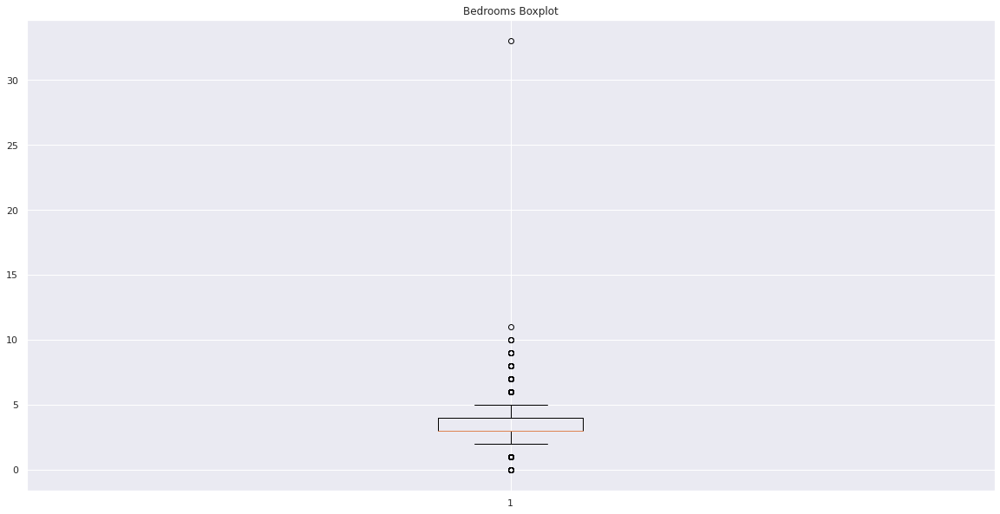

In [35]:
plt.boxplot(data['bedrooms'])
plt.title('Bedrooms Boxplot')

In [36]:
q1, q3 = np.percentile(data['bedrooms'], [25, 75])
deq = q3 - q1
cii = q1 - (deq * 1.5) 
cis = q3 + (deq * 1.5)
cei = cii - (deq * 1.5) 
ces = cis + (deq * 1.5)

print(f'The upper inner fence is {cis} and lower inner fence is {cii}') # cis < x < cii - outliers
print(f'The upper outer fence is {ces} and lower outer fence is {cei}') # ces < x < cei - values more than discrepant

The upper inner fence is 5.5 and lower inner fence is 1.5
The upper outer fence is 7.0 and lower outer fence is 0.0


In [37]:
dfOutliersBedrooms = data.loc[(data['bedrooms'] > ces) | (data['bedrooms'] < cei)]
dfOutliersBedrooms

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,year,month,days
1645,9126101740,2014-12-04,490000.0,8,5.00,2800,2580,2.0,No,bad,regular,avg_quality_design,1880,920,1997,0,98122,47.6086,-122.303,2014,12,4
4001,685000115,2014-10-07,2150000.0,8,6.00,4340,9415,2.0,No,bad,regular,avg_quality_design,4340,0,1967,0,98004,47.6316,-122.202,2014,10,7
4033,7226500100,2015-02-19,373000.0,8,3.00,2850,12714,1.0,No,bad,regular,avg_quality_design,2850,0,1959,0,98055,47.4859,-122.205,2015,2,19
4061,1997200215,2014-05-07,599999.0,9,4.50,3830,6988,2.5,No,bad,regular,avg_quality_design,2450,1380,1938,0,98103,47.6927,-122.338,2014,5,7
4200,2902200015,2015-01-06,700000.0,9,3.00,3680,4400,2.0,No,bad,regular,avg_quality_design,2830,850,1908,0,98102,47.6374,-122.324,2015,1,6
6031,9822700190,2014-08-08,1280000.0,9,4.50,3650,5000,2.0,No,bad,regular,avg_quality_design,2530,1120,1915,2010,98105,47.6604,-122.289,2014,8,8
6126,1873400020,2014-07-03,340000.0,8,2.75,2790,6695,1.0,No,bad,regular,avg_quality_design,1470,1320,1977,0,98133,47.7565,-122.331,2014,7,3
8478,424049043,2014-08-11,450000.0,9,7.50,4050,6504,2.0,No,bad,regular,avg_quality_design,4050,0,1996,0,98144,47.5923,-122.301,2014,8,11
8688,1773100755,2014-08-21,520000.0,11,3.00,3000,4960,2.0,No,bad,regular,avg_quality_design,2400,600,1918,1999,98106,47.5560,-122.363,2014,8,21
9005,6746700615,2015-03-18,700000.0,8,2.50,2280,3000,1.5,No,bad,regular,avg_quality_design,1210,1070,1911,0,98105,47.6675,-122.316,2015,3,18


In [38]:
dfOutliersBedrooms[['bedrooms', 'sqft_living']].groupby(['bedrooms']).count()

,sqft_living
bedrooms,
8,13
9,6
10,3
11,1
33,1


In [39]:
#In this dataset only will allow properties with up to 11 bedrooms.

In [40]:
#Property with 33 bedrooms
sqftLivingBedroom33 = data['sqft_living'].loc[data['bedrooms'] == 33].reset_index(drop= True)[0]

percent30 = sqftLivingBedroom33 * 0.3
dfSqftBed33Percent30 = data[['bedrooms', 'sqft_living']].loc[(data['sqft_living'] <= sqftLivingBedroom33 + percent30) & (data['sqft_living'] >= sqftLivingBedroom33 - percent30)]

print(dfSqftBed33Percent30.mean())
print(dfSqftBed33Percent30.median())

#Median number od bedrooms to house size() of the + or - 30% of 1620ft² equals 3!
#Soon line with 33 bedrooms will be changed to 3 bedrooms

bedrooms          3.143380
sqft_living    1619.285969
dtype: float64
bedrooms          3.0
sqft_living    1620.0
dtype: float64


In [41]:
medianBedrooms = dfSqftBed33Percent30['bedrooms'].median()
medianBedrooms

3.0

In [42]:
data.loc[data['bedrooms'] == 33, 'bedrooms'] = medianBedrooms

In [43]:
#Analyzing and tranforming sqft_lot outliers

Text(0.5, 1.0, 'Square Feet Lot Boxplot')

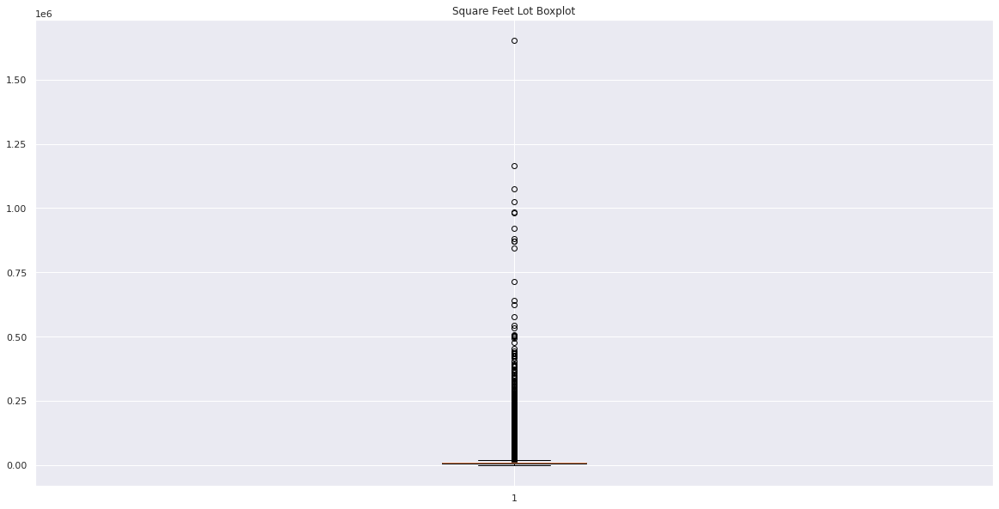

In [44]:
plt.boxplot(data['sqft_lot'])
plt.title('Square Feet Lot Boxplot')

In [45]:
q1, q3 = np.percentile(data['sqft_lot'], [25, 75])
deq = q3 - q1
cii = q1 - (deq * 1.5) 
cis = q3  + (deq  * 1.5)
cei = cii  - (deq * 1.5) 
ces = cis + (deq * 1.5)
if cii < 0:
    cii = 0
if cei < 0:
    cei = 0

print(f'The upper inner fence is {cis} and lower inner fence is {cii}') # cis < x or x < cii - outliers
print(f'The upper outer fence is {ces} and lower outer fence is {cei}') # ces < x or x < cei - values more than discrepant

The upper inner fence is 19180.625 and lower inner fence is 0
The upper outer fence is 27665.0 and lower outer fence is 0


In [46]:
#There are many values that are outliers, but for business reasons, only values above 1.0M ft² will be considered outliers.

In [47]:
dfOutliersSqftLot = data.loc[data['sqft_lot']> 1000000].sort_values(['sqft_lot'], ascending= True)
dfOutliersSqftLot

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,year,month,days
7711,2323089009,2015-01-19,855000.0,4,3.50,4030,1024068,2.0,No,bad,regular,avg_quality_design,4030,0,2006,0,98045,47.4619,-121.744,2015,1,19
7589,2623069031,2014-05-21,542500.0,5,3.25,3010,1074218,1.5,No,bad,good,avg_quality_design,2010,1000,1931,0,98027,47.4564,-122.004,2014,5,21
17164,3326079016,2015-05-04,190000.0,2,1.00,710,1164794,1.0,No,bad,bad,avg_quality_design,710,0,1915,0,98014,47.6888,-121.909,2015,5,4
1704,1020069017,2015-03-27,700000.0,4,1.00,1300,1651359,1.0,No,good,regular,avg_quality_design,1300,0,1920,0,98022,47.2313,-122.023,2015,3,27


In [48]:
meanPrice= dfOutliersSqftLot['price'].mean()
meanPrice

571875.0

In [49]:
percent10 = meanPrice * 0.1

dfPricePercent10 = data[['price', 'sqft_lot']].loc[(data['price'] > meanPrice - percent10) & (data['price'] < meanPrice + percent10)]
dfPricePercent10

,price,sqft_lot
1,538000.0,7242
3,604000.0,5000
14,530000.0,4850
30,580500.0,3980
33,535000.0,3000
36,550000.0,34848
39,605000.0,7553
40,625000.0,5520
52,600000.0,4080
53,585000.0,8550


In [50]:
meanDf = round(dfPricePercent10.mean(), 2)
medianDf = round(dfPricePercent10.median(), 2)
print(meanDf)
print(medianDf)

price       566754.48
sqft_lot     16793.04
dtype: float64
price       564500.0
sqft_lot      7064.0
dtype: float64


In [51]:
data.loc[data['sqft_lot']> 1000000, 'sqft_lot'] = meanDf['sqft_lot']

<AxesSubplot:>

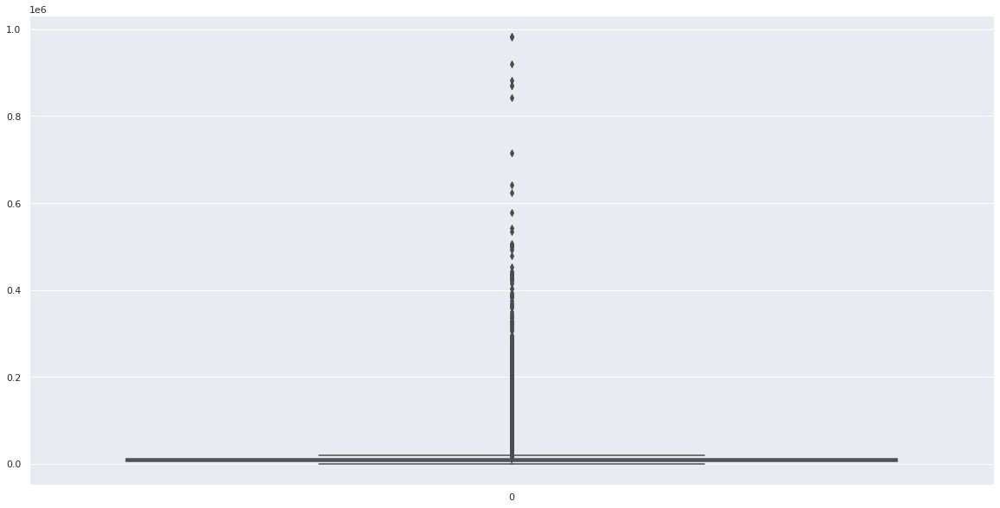

In [52]:
plt.boxplot(data['sqft_lot'])
plt.title('Square Feet Lot Boxplot')

In [53]:
#Reseting index
data.reset_index(drop= True, inplace= True)
data

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,year,month,days
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650.00,1.0,No,bad,regular,avg_quality_design,1180,0,1955,0,98178,47.5112,-122.257,2014,10,13
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242.00,2.0,No,bad,regular,avg_quality_design,2170,400,1951,1991,98125,47.7210,-122.319,2014,12,9
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000.00,1.0,No,bad,regular,avg_quality_design,770,0,1933,0,98028,47.7379,-122.233,2015,2,25
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000.00,1.0,No,bad,good,avg_quality_design,1050,910,1965,0,98136,47.5208,-122.393,2014,12,9
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080.00,1.0,No,bad,regular,avg_quality_design,1680,0,1987,0,98074,47.6168,-122.045,2015,2,18
5,7237550310,2014-05-12,1225000.0,4,4.50,5420,101930.00,1.0,No,bad,regular,high_quality_design,3890,1530,2001,0,98053,47.6561,-122.005,2014,5,12
6,1321400060,2014-06-27,257500.0,3,2.25,1715,6819.00,2.0,No,bad,regular,avg_quality_design,1715,0,1995,0,98003,47.3097,-122.327,2014,6,27
7,2008000270,2015-01-15,291850.0,3,1.50,1060,9711.00,1.0,No,bad,regular,avg_quality_design,1060,0,1963,0,98198,47.4095,-122.315,2015,1,15
8,2414600126,2015-04-15,229500.0,3,1.00,1780,7470.00,1.0,No,bad,regular,avg_quality_design,1050,730,1960,0,98146,47.5123,-122.337,2015,4,15
9,3793500160,2015-03-12,323000.0,3,2.50,1890,6560.00,2.0,No,bad,regular,avg_quality_design,1890,0,2003,0,98038,47.3684,-122.031,2015,3,12


In [54]:
display(data.head())

dimensionData = data.shape
print(f'This dataset has {dimensionData[0]} properties and {dimensionData[1]} available attributes.')

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,year,month,days
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650.0,1.0,No,bad,regular,avg_quality_design,1180,0,1955,0,98178,47.5112,-122.257,2014,10,13
1,6414100192,2014-12-09,538000.0,3,2.25,2570,7242.0,2.0,No,bad,regular,avg_quality_design,2170,400,1951,1991,98125,47.7210,-122.319,2014,12,9
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000.0,1.0,No,bad,regular,avg_quality_design,770,0,1933,0,98028,47.7379,-122.233,2015,2,25
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000.0,1.0,No,bad,good,avg_quality_design,1050,910,1965,0,98136,47.5208,-122.393,2014,12,9
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080.0,1.0,No,bad,regular,avg_quality_design,1680,0,1987,0,98074,47.6168,-122.045,2015,2,18


This dataset has 21436 properties and 22 available attributes.


### Solving Business Problems

#### What properties should House Rocket buy?

In [55]:
#First Solution

In [56]:
dataRaw = data.copy()

In [57]:
dfGroupZipcodeMedianPrice = dataRaw[['price', 'zipcode']].groupby(['zipcode']).median()
dfGroupZipcodeMedianPrice

,price
zipcode,
98001,260000.0
98002,235000.0
98003,266500.0
98004,1150000.0
98005,765475.0
98006,760000.0
98007,555000.0
98008,545000.0
98010,359999.0


In [58]:
dataRaw['average_price_status_per_zipcode'] = 'NaN'
for i in range(len(dfGroupZipcodeMedianPrice)):
    prices = data['price'].loc[dataRaw['zipcode'] == dfGroupZipcodeMedianPrice.index[i]]
    for row in range(len(prices)):
        idx = prices.index[row]
        
        if prices.iloc[row] >= dfGroupZipcodeMedianPrice['price'].iloc[i]:
            dataRaw['average_price_status_per_zipcode'].iloc[idx] = 'above median'
        else:
            dataRaw['average_price_status_per_zipcode'].iloc[idx] = 'bellow median'

In [59]:
dataRaw.rename(columns= {'price': 'buy_price'}, inplace= True)

In [60]:
dataBuy = dataRaw[['id','date', 'zipcode', 'condition', 'buy_price', 'average_price_status_per_zipcode']].loc[(dataRaw['average_price_status_per_zipcode'] == 'bellow median') & 
                                                                                                (dataRaw['condition'] != 'bad') & 
                                                                                                (dataRaw['view'] != 'bad') & 
                                                                                                (dataRaw['waterfront'] == 'Yes')].reset_index(drop= True)
dataBuy

,id,date,zipcode,condition,buy_price,average_price_status_per_zipcode
0,2123039032,2014-10-27,98070,good,369900.0,bellow median
1,3523029041,2014-10-09,98070,regular,290000.0,bellow median
2,8550001515,2014-10-01,98070,good,429592.0,bellow median
3,222029026,2014-09-17,98070,good,340000.0,bellow median
4,221029019,2015-04-28,98070,regular,400000.0,bellow median
5,2923039243,2014-11-13,98070,regular,340000.0,bellow median
6,2781600195,2014-11-17,98070,regular,285000.0,bellow median
7,7631800110,2014-09-18,98166,regular,380000.0,bellow median
8,5216200090,2014-06-16,98070,regular,385000.0,bellow median


In [61]:
#Second Solution

In [62]:
dataRaw2 = data.copy()

In [63]:
dfGroupZipcodeMedianPrice = dataRaw2[['price', 'zipcode']].groupby(['zipcode']).median().reset_index()
dfGroupZipcodeMedianPrice.rename(columns= {'price':'average_price_per_zipcode'}, inplace= True)
dfGroupZipcodeMedianPrice.head()

,zipcode,average_price_per_zipcode
0,98001,260000.0
1,98002,235000.0
2,98003,266500.0
3,98004,1150000.0
4,98005,765475.0


In [64]:
dataRaw2 = pd.merge(dataRaw2, dfGroupZipcodeMedianPrice, on= 'zipcode') 
dataRaw2.head(10)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,year,month,days,average_price_per_zipcode
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650.0,1.0,No,bad,regular,avg_quality_design,1180,0,1955,0,98178,47.5112,-122.257,2014,10,13,279000.0
1,4060000240,2014-06-23,205425.0,2,1.00,880,6780.0,1.0,No,bad,regular,avg_quality_design,880,0,1945,0,98178,47.5009,-122.248,2014,6,23,279000.0
2,4058801670,2014-07-17,445000.0,3,2.25,2100,8201.0,1.0,No,regular,regular,avg_quality_design,1620,480,1967,0,98178,47.5091,-122.244,2014,7,17,279000.0
3,2976800796,2014-09-25,236000.0,3,1.00,1300,5898.0,1.0,No,bad,regular,avg_quality_design,1300,0,1961,0,98178,47.5053,-122.255,2014,9,25,279000.0
4,6874200960,2015-02-27,170000.0,2,1.00,860,5265.0,1.0,No,bad,regular,avg_quality_design,860,0,1931,0,98178,47.5048,-122.272,2015,2,27,279000.0
5,4268200055,2015-05-01,245000.0,3,1.75,1740,11547.0,1.0,No,bad,regular,avg_quality_design,1740,0,1954,0,98178,47.4945,-122.220,2015,5,1,279000.0
6,3969300030,2014-07-23,165000.0,4,1.00,1000,7134.0,1.0,No,bad,regular,avg_quality_design,1000,0,1943,0,98178,47.4897,-122.240,2014,7,23,279000.0
7,1678400105,2015-02-12,339000.0,4,1.50,2390,7480.0,1.5,No,regular,regular,avg_quality_design,2390,0,1920,0,98178,47.5040,-122.227,2015,2,12,279000.0
8,2172000075,2014-06-23,290900.0,2,2.00,1610,17600.0,2.0,No,bad,regular,avg_quality_design,1610,0,1930,1983,98178,47.4855,-122.266,2014,6,23,279000.0
9,1180003090,2014-09-06,190000.0,2,1.00,630,6000.0,1.0,No,bad,regular,avg_quality_design,630,0,1943,2005,98178,47.4973,-122.221,2014,9,6,279000.0


In [65]:
dataRaw2.rename(columns= {'price': 'buy_price'}, inplace= True)

In [66]:
#loc
dataBuy = dataRaw2[['id','date', 'zipcode', 'condition', 'buy_price', 'average_price_per_zipcode']].loc[(dataRaw2['buy_price'] < dataRaw2['average_price_per_zipcode']) & 
                                                                                                        (dataRaw2['condition'] != 'bad') & 
                                                                                                        (dataRaw2['view'] != 'bad') & 
                                                                                                        (dataRaw2['waterfront'] == 'Yes')].reset_index(drop= True)
dataBuy

,id,date,zipcode,condition,buy_price,average_price_per_zipcode
0,7631800110,2014-09-18,98166,regular,380000.0,390000.0
1,2123039032,2014-10-27,98070,good,369900.0,465000.0
2,3523029041,2014-10-09,98070,regular,290000.0,465000.0
3,8550001515,2014-10-01,98070,good,429592.0,465000.0
4,222029026,2014-09-17,98070,good,340000.0,465000.0
5,221029019,2015-04-28,98070,regular,400000.0,465000.0
6,2923039243,2014-11-13,98070,regular,340000.0,465000.0
7,2781600195,2014-11-17,98070,regular,285000.0,465000.0
8,5216200090,2014-06-16,98070,regular,385000.0,465000.0


In [67]:
#Saving Dataframe
dataBuy.to_csv('../Datasets/properties_to_be_purchased.csv', index= False)

#### Once homes has been purchased, when is the best time to sell them and at what price?

In [68]:
#Summer: June(6) 21st to September(9) 23rd;
#Fall: September(9) 22 or 23 to December(12) 22;
#Winter: December(12) 22nd to March(3) 20th;
#Spring: March(3) 20th to June(6) 21st.

In [69]:
dataRaw3 = data.copy()

In [70]:
data['seasonality'] = 'NaN'

dataRaw3.loc[(dataRaw3['date'] >= '2014-06-21') & (dataRaw3['date'] < '2014-09-23'), 'seasonality'] = 'Summer'

dataRaw3.loc[(dataRaw3['date'] >= '2014-09-23') & (dataRaw3['date'] < '2014-12-22'), 'seasonality'] = 'Fall'

dataRaw3.loc[(dataRaw3['date'] >= '2014-12-22') & (dataRaw3['date'] < '2015-03-20'), 'seasonality'] = 'Winter'

dataRaw3.loc[(dataRaw3['date'] < '2014-06-21') | (dataRaw3['date'] >= '2015-03-20'), 'seasonality'] = 'Spring'

In [71]:
#The best time to sell real estate is in the spring, when properties prices are at their highest.

In [72]:
dfMedianZipcodeSeason = dataRaw3[['price', 'zipcode', 'seasonality']].groupby(['zipcode', 'seasonality']).median().reset_index()
dfMedianZipcodeSeason.set_index('zipcode', inplace= True)
dfMedianZipcodeSeason

,seasonality,price
zipcode,,
98001,Fall,250000.0
98001,Spring,265000.0
98001,Summer,262500.0
98001,Winter,260000.0
98002,Fall,236500.0
98002,Spring,228801.5
98002,Summer,231750.0
98002,Winter,237950.0
98003,Fall,257750.0


In [73]:
dataSale = pd.merge(dataRaw3[['id', 'seasonality', 'view', 'waterfront']], dataBuy, on= 'id', how= 'right')
dataSale

,id,seasonality,view,waterfront,date,zipcode,condition,buy_price,average_price_per_zipcode
0,7631800110,Summer,good,Yes,2014-09-18,98166,regular,380000.0,390000.0
1,2123039032,Fall,good,Yes,2014-10-27,98070,good,369900.0,465000.0
2,3523029041,Fall,good,Yes,2014-10-09,98070,regular,290000.0,465000.0
3,8550001515,Fall,good,Yes,2014-10-01,98070,good,429592.0,465000.0
4,222029026,Summer,regular,Yes,2014-09-17,98070,good,340000.0,465000.0
5,221029019,Spring,good,Yes,2015-04-28,98070,regular,400000.0,465000.0
6,2923039243,Fall,good,Yes,2014-11-13,98070,regular,340000.0,465000.0
7,2781600195,Fall,good,Yes,2014-11-17,98070,regular,285000.0,465000.0
8,5216200090,Spring,good,Yes,2014-06-16,98070,regular,385000.0,465000.0


In [74]:
dataSale['sale_price'] = 'NaN'
dataSale['average_price_per_zip_and_season'] = 'NaN'

zipcodes = list(dataSale['zipcode'].unique())

for i in range(len(zipcodes)):
    priceAndSeason = dataSale[['zipcode', 'buy_price', 'seasonality']].loc[dataSale['zipcode'] == zipcodes[i]]
                                                       
    for row in range(len(priceAndSeason)):
        idx = priceAndSeason.index[row]
        seasonality = priceAndSeason['seasonality'].iloc[row]
                                                        
        dfLoc = dfMedianZipcodeSeason.loc[(dfMedianZipcodeSeason.index == zipcodes[i]) &
                        (dfMedianZipcodeSeason['seasonality'] == seasonality)]
                                                        
        if priceAndSeason['buy_price'].iloc[row] > dfLoc['price'].iloc[0]:
            dataSale['sale_price'].iloc[idx] = dataSale['buy_price'].iloc[idx] * 1.1
            dataSale['average_price_per_zip_and_season'].iloc[idx] = dfLoc['price'].iloc[0]
        else:
            dataSale['sale_price'].iloc[idx] = dataSale['buy_price'].iloc[idx] * 1.3
            dataSale['average_price_per_zip_and_season'].iloc[idx] = dfLoc['price'].iloc[0]
            
dataSale

,id,seasonality,view,waterfront,date,zipcode,condition,buy_price,average_price_per_zipcode,sale_price,average_price_per_zip_and_season
0,7631800110,Summer,good,Yes,2014-09-18,98166,regular,380000.0,390000.0,494000.0,402000.0
1,2123039032,Fall,good,Yes,2014-10-27,98070,good,369900.0,465000.0,480870.0,429592.0
2,3523029041,Fall,good,Yes,2014-10-09,98070,regular,290000.0,465000.0,377000.0,429592.0
3,8550001515,Fall,good,Yes,2014-10-01,98070,good,429592.0,465000.0,558469.6,429592.0
4,222029026,Summer,regular,Yes,2014-09-17,98070,good,340000.0,465000.0,442000.0,496000.0
5,221029019,Spring,good,Yes,2015-04-28,98070,regular,400000.0,465000.0,520000.0,441000.0
6,2923039243,Fall,good,Yes,2014-11-13,98070,regular,340000.0,465000.0,442000.0,429592.0
7,2781600195,Fall,good,Yes,2014-11-17,98070,regular,285000.0,465000.0,370500.0,429592.0
8,5216200090,Spring,good,Yes,2014-06-16,98070,regular,385000.0,465000.0,500500.0,441000.0


In [75]:
dataSale = dataSale[['id', 'date', 'zipcode','condition', 'view', 'waterfront','buy_price', 'seasonality', 'average_price_per_zip_and_season', 'sale_price']]
dataSale

,id,date,zipcode,condition,view,waterfront,buy_price,seasonality,average_price_per_zip_and_season,sale_price
0,7631800110,2014-09-18,98166,regular,good,Yes,380000.0,Summer,402000.0,494000.0
1,2123039032,2014-10-27,98070,good,good,Yes,369900.0,Fall,429592.0,480870.0
2,3523029041,2014-10-09,98070,regular,good,Yes,290000.0,Fall,429592.0,377000.0
3,8550001515,2014-10-01,98070,good,good,Yes,429592.0,Fall,429592.0,558469.6
4,222029026,2014-09-17,98070,good,regular,Yes,340000.0,Summer,496000.0,442000.0
5,221029019,2015-04-28,98070,regular,good,Yes,400000.0,Spring,441000.0,520000.0
6,2923039243,2014-11-13,98070,regular,good,Yes,340000.0,Fall,429592.0,442000.0
7,2781600195,2014-11-17,98070,regular,good,Yes,285000.0,Fall,429592.0,370500.0
8,5216200090,2014-06-16,98070,regular,good,Yes,385000.0,Spring,441000.0,500500.0


In [76]:
dataSale['gain'] = 'Null'

for i in range(len(dataSale)):
    dataSale.loc[i, 'gain'] = dataSale.loc[i, 'sale_price'] - dataSale.loc[i, 'buy_price']
    
dataSale

,id,date,zipcode,condition,view,waterfront,buy_price,seasonality,average_price_per_zip_and_season,sale_price,gain
0,7631800110,2014-09-18,98166,regular,good,Yes,380000.0,Summer,402000.0,494000.0,114000.0
1,2123039032,2014-10-27,98070,good,good,Yes,369900.0,Fall,429592.0,480870.0,110970.0
2,3523029041,2014-10-09,98070,regular,good,Yes,290000.0,Fall,429592.0,377000.0,87000.0
3,8550001515,2014-10-01,98070,good,good,Yes,429592.0,Fall,429592.0,558469.6,128877.6
4,222029026,2014-09-17,98070,good,regular,Yes,340000.0,Summer,496000.0,442000.0,102000.0
5,221029019,2015-04-28,98070,regular,good,Yes,400000.0,Spring,441000.0,520000.0,120000.0
6,2923039243,2014-11-13,98070,regular,good,Yes,340000.0,Fall,429592.0,442000.0,102000.0
7,2781600195,2014-11-17,98070,regular,good,Yes,285000.0,Fall,429592.0,370500.0,85500.0
8,5216200090,2014-06-16,98070,regular,good,Yes,385000.0,Spring,441000.0,500500.0,115500.0


In [77]:
#Saving Dataframe 
dataSale.to_csv('../Datasets/gain_from_sale_of_properties.csv', index= False)

###  Hypothesis Validation

The average price of properties with water views is US$1661876.02
The average price for properties that do not have water views is US$531937.2
Properties that have a view of the water are 212.42% more expensive, on average, than those that don´t view to water


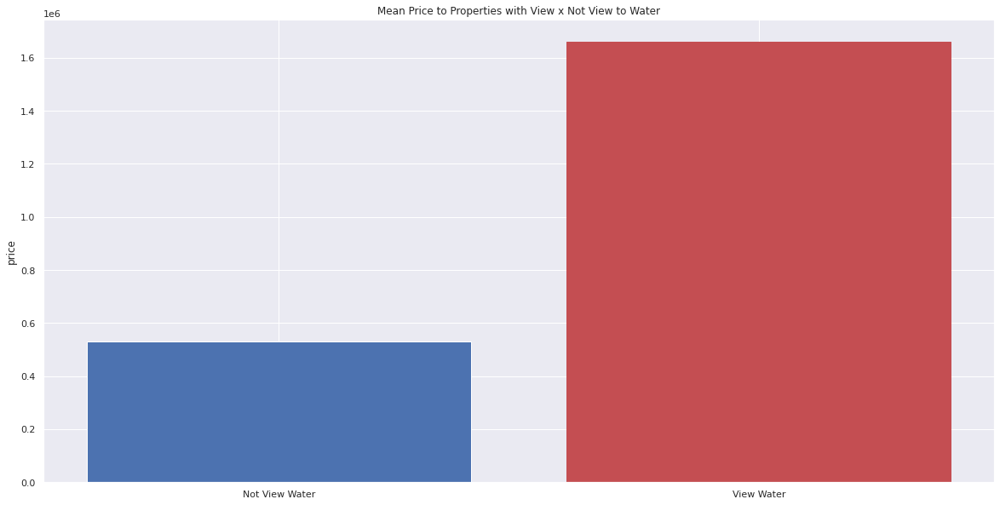

In [78]:
#H1: Properties that have a view of the water are 100% more expensive, on average, than those that do not have a view of the water.
viewWater = round(data['price'].loc[(data['waterfront'] == 'Yes')].mean(), 2)
print(f'The average price of properties with water views is US${viewWater}')

notViewWater = round(data['price'].loc[data['waterfront'] == 'No'].mean(), 2)
print(f'The average price for properties that do not have water views is US${notViewWater}')

rate = round((viewWater - notViewWater ) / notViewWater * 100, 2)
print(f'Properties that have a view of the water are {rate}% more expensive, on average, than those that don´t view to water')

groups = ['Not View Water', 'View Water']
values = [notViewWater, viewWater]
barlist = plt.bar(groups, values)
barlist[1].set_color('r')
plt. title('Mean Price to Properties with View x Not View to Water')
plt.ylabel('price')
plt.show()

The average price of properties that do not have good water views is US$635000.0
The average price for properties with good water views is US$1668214.77
Properties that have a good view of the water are 162.71% more expensive, on average, than those that don´t good view to water


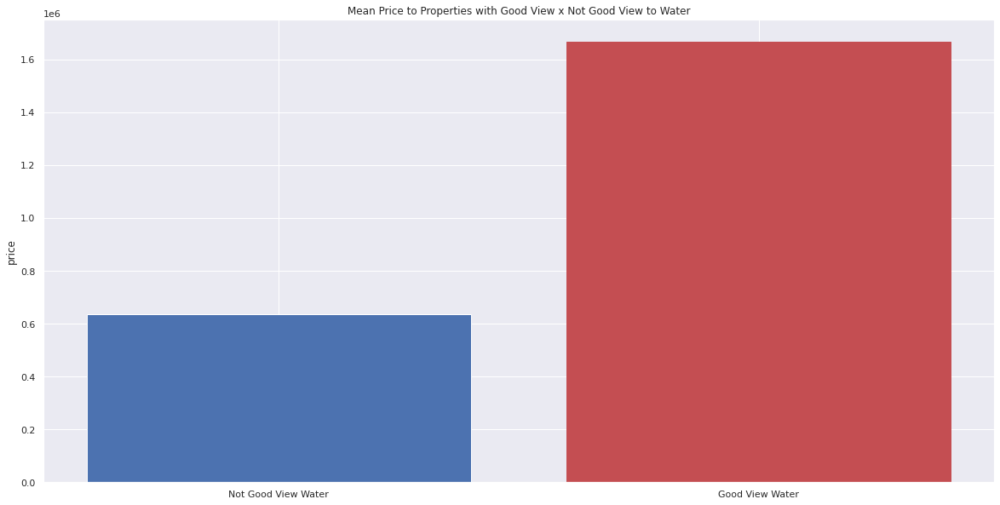

In [79]:
#H2: Properties that have a good and regular view of the water are 80% more expensive, on average, than those that have a bad view of the water;
notGoodViewWater = round(data['price'].loc[(data['waterfront'] == 'Yes') & (data['view'] == 'bad')].mean(), 2)
print(f'The average price of properties that do not have good water views is US${notGoodViewWater}')

goodViewWater = round(data['price'].loc[(data['waterfront'] == 'Yes') & (data['view'] != 'bad')].mean(), 2)
print(f'The average price for properties with good water views is US${goodViewWater}')

rate = round((goodViewWater - notGoodViewWater ) / notGoodViewWater * 100, 2)
print(f'Properties that have a good view of the water are {rate}% more expensive, on average, than those that don´t good view to water')

grupos = ['Not Good View Water', 'Good View Water']
valores = [notGoodViewWater, goodViewWater]
barlist = plt.bar(grupos, valores)
barlist[1].set_color('r')
plt. title('Mean Price to Properties with Good View x Not Good View to Water')
plt.ylabel('price')
plt.show()

The average price for properties with years of construction after 1955 is US$541478.25
The average price for properties with years of contruction prior to 1955 is US$538139.13
Properties with years of construction prior to 1955 are 0.62% cheaper than the total average.


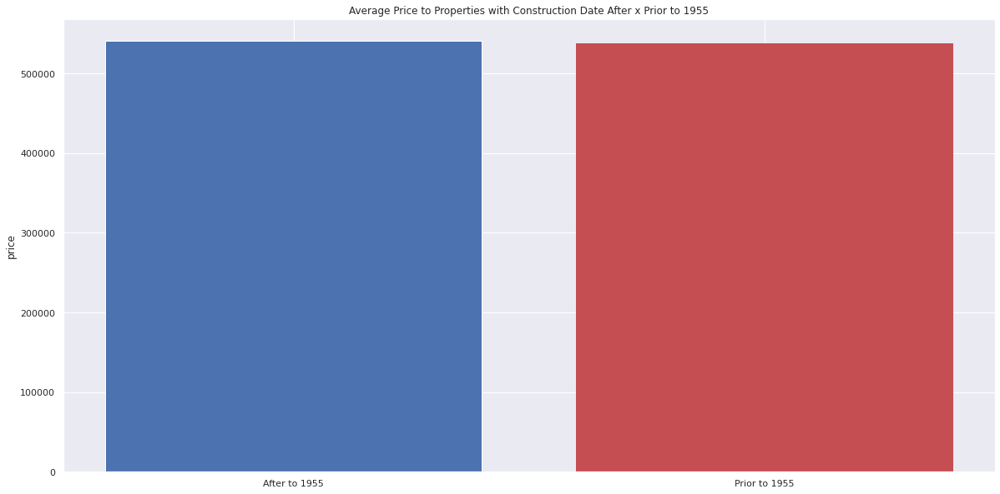

In [80]:
#H3: Properties with a construction date before 1955 are 50% cheaper, on average, than those with a construction date after 1955.
after1995 = round(data['price'].loc[data['yr_built'] >= 1955].mean(), 2)
print(f'The average price for properties with years of construction after 1955 is US${after1995}')

prior1955 = round(data['price'].loc[data['yr_built'] < 1955].mean(), 2)
print(f'The average price for properties with years of contruction prior to 1955 is US${prior1955}')

rate1 = abs(round((prior1955 - after1995) / after1995 * 100, 2))
print(f'Properties with years of construction prior to 1955 are {rate1}% cheaper than the total average.')

grupos = ['After to 1955', 'Prior to 1955']
valores = [after1995, prior1955]
barlist = plt.bar(grupos, valores)
barlist[1].set_color('r')
plt. title('Average Price to Properties with Construction Date After x Prior to 1955')
plt.ylabel('price')
plt.show()

The land area for property that has a basement is 13170.42ft²
The land area for property that does not have a basement is 16034.74ft²
Properties without a basement have a land area 21.75% larger than those with a basement.


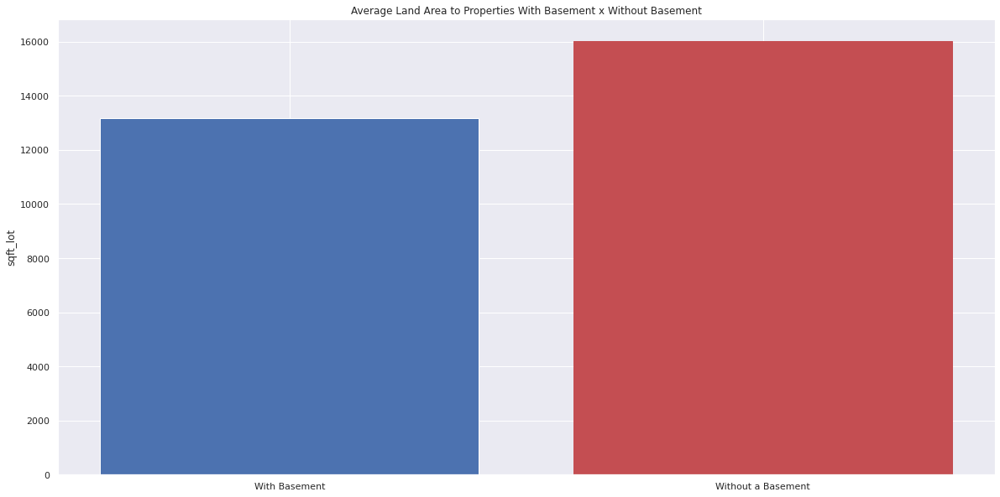

In [81]:
#H4: Properties without a basement have a land area 50% larger than those with a basement.
withBasement = round(data['sqft_lot'].loc[data['sqft_basement'] > 0].mean(), 2)
print(f'The land area for property that has a basement is {withBasement}ft²')

noBasement = round(data['sqft_lot'].loc[data['sqft_basement'] == 0].mean(), 2)
print(f'The land area for property that does not have a basement is {noBasement}ft²')

rate2 = round((noBasement - withBasement) / withBasement * 100, 2)
print(f'Properties without a basement have a land area {rate2}% larger than those with a basement.')

grupos = ['With Basement', 'Without a Basement']
valores = [withBasement, noBasement]
barlist = plt.bar(grupos, valores)
barlist[1].set_color('r')
plt. title('Average Land Area to Properties With Basement x Without Basement')
plt.ylabel('sqft_lot')
plt.show()

The mean price the properties in year 2014 is: R$539321.49
The mean price the properties in year 2015 is: R$543108.29
There was a growth in property prices of 0.7% from 2014 to 2015.


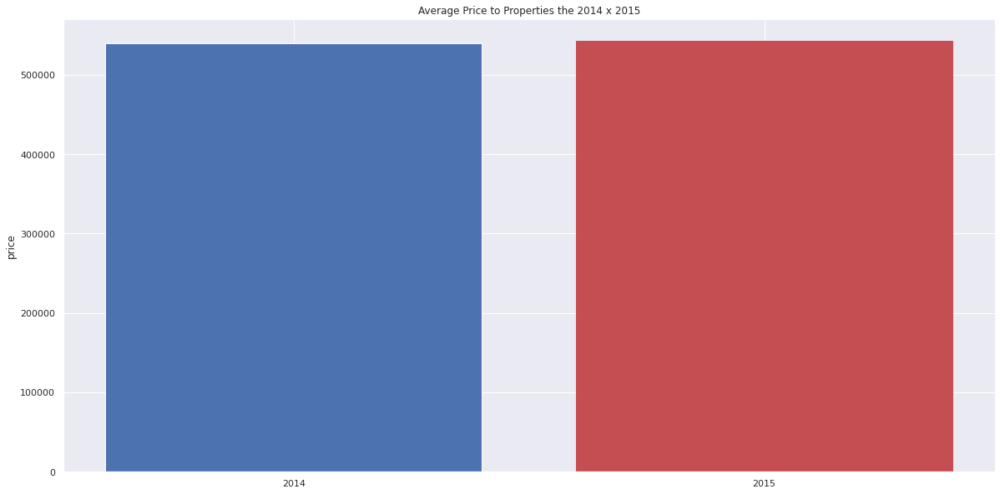

In [82]:
#H5: YoY ( Year over Year ) property price growth is 10%
year2014 = round(data['price'].loc[data['year'] == 2014].mean(), 2)
print(f'The mean price the properties in year 2014 is: R${year2014}')

year2015 = round(data['price'].loc[data['year'] == 2015].mean(), 2)
print(f'The mean price the properties in year 2015 is: R${year2015}')

growthYear = round((year2015 - year2014) / year2014 * 100, 2)
print(f'There was a growth in property prices of {growthYear}% from 2014 to 2015.')

grupos = ['2014', '2015']
valores = [year2014, year2015]
barlist = plt.bar(grupos, valores)
barlist[1].set_color('r')
plt. title('Average Price to Properties the 2014 x 2015')
plt.ylabel('price')
plt.show()

There was a 1.14% monthly decrease in the average price for properties with 3 bathrooms (from 2014-05 to 2015-05)


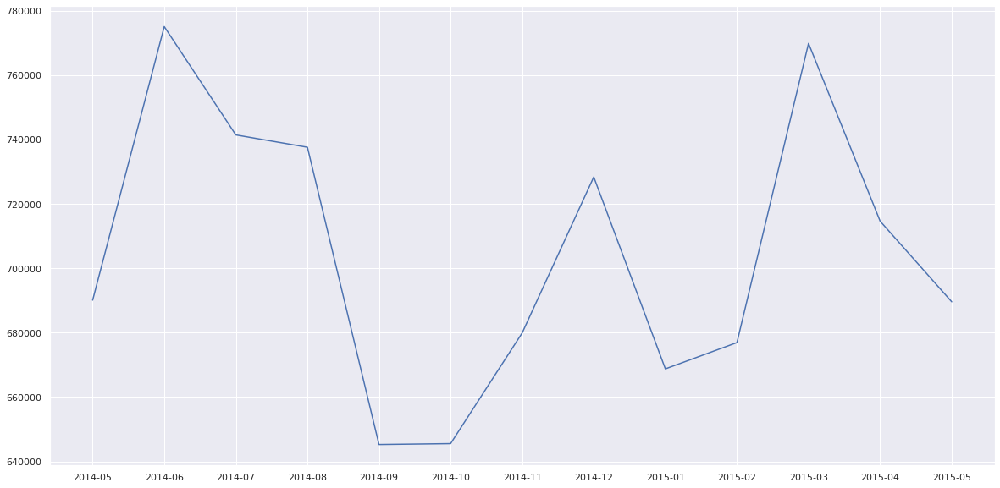

In [83]:
#H6: Properties with 3 bathrooms have an average MoM (Month over Month) growth of 15%
property3Bathrooms = data[['price','date','month', 'year']].loc[data['bathrooms'] == 3]
property3Bathrooms = property3Bathrooms.sort_values(['date']).reset_index(drop= True)
##2014-05-02 > 2015-05-14 = 12 month

priceMinMonth = property3Bathrooms['price'].loc[(data['month'] == 5) & (data['year'] == 2014)].mean()
priceMaxMonth = property3Bathrooms['price'].loc[(data['month'] == 5) & (data['year'] == 2015)].mean()

growth_rate = (((priceMaxMonth / priceMinMonth) ** (1/12)) - 1) * 100

print(f'There was a {abs(round(growth_rate, 2))}% monthly decrease in the average price for properties with 3 bathrooms (from 2014-05 to 2015-05)')

dataH5 = data.copy()
dataH5['year and month'] = pd.to_datetime(dataH5['date']).dt.strftime('%Y-%m')
groupYearAndMonth = dataH5[['price', 'year and month']].loc[dataH5['bathrooms'] == 3].groupby('year and month').mean().reset_index()
plt.plot(groupYearAndMonth['year and month'], groupYearAndMonth['price'])

The average dataset price is US$540529.29
The average price of renovates property is US$761718.5
Renovated properties are 40.92% more expensive compared to the total average.


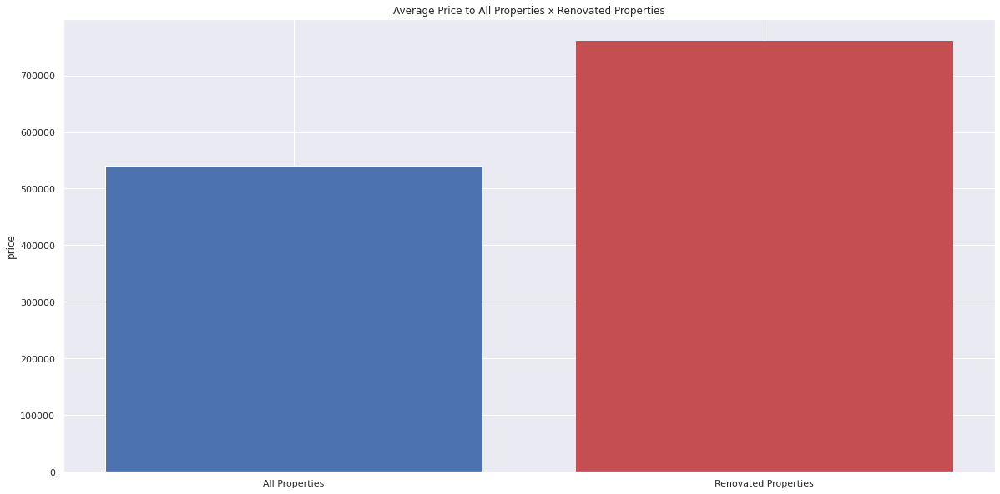

In [84]:
#H7: Renovated properties are 15% or more expensive compared to the total average
dataMean = round(data['price'].mean(), 2)
print(f'The average dataset price is US${dataMean}')

dfRenovated = round(data['price'].loc[data['yr_renovated'] > 0].mean(), 2)
print(f'The average price of renovates property is US${dfRenovated}')

rate3 = round((dfRenovated - dataMean) / dataMean * 100, 2)
print(f'Renovated properties are {rate3}% more expensive compared to the total average.')

grupos = ['All Properties', 'Renovated Properties']
valores = [dataMean, dfRenovated]
barlist = plt.bar(grupos, valores)
barlist[1].set_color('r')
plt. title('Average Price to All Properties x Renovated Properties')
plt.ylabel('price')
plt.show()

The average dataset price is US$540529.29
The average price for properties with more than 3 bedrooms is US$671489.37
Properties with more than 3 bedrooms are 24.23% more expensive compared to the total average.


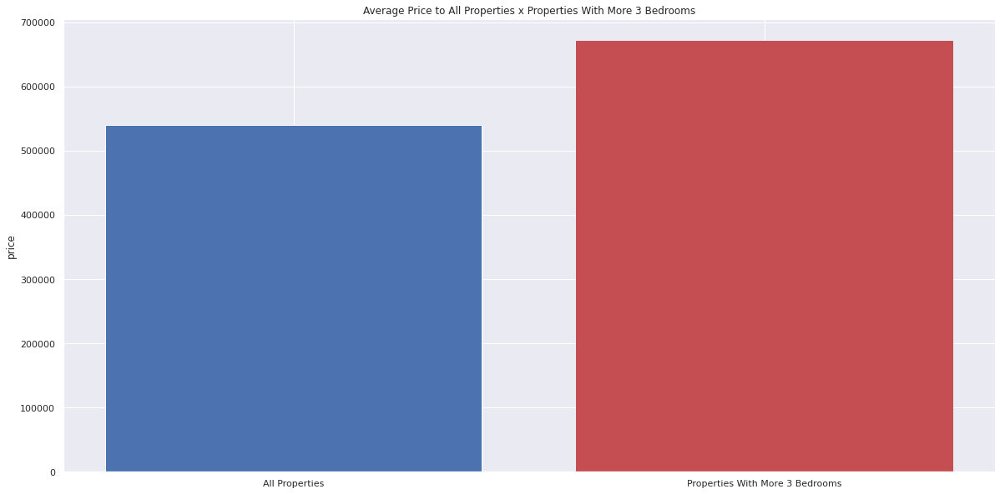

In [85]:
#H8: Properties with more than 3 bedrooms are 20% or more expensive compared to the total average
dataMean = round(data['price'].mean(), 2)
print(f'The average dataset price is US${dataMean}')

more3Bedrooms = round(data['price'].loc[data['bedrooms'] > 3].mean(), 2)
print(f'The average price for properties with more than 3 bedrooms is US${more3Bedrooms}')

rate4 = round((more3Bedrooms - dataMean) / dataMean * 100, 2)
print(f'Properties with more than 3 bedrooms are {rate4}% more expensive compared to the total average.')

grupos = ['All Properties', 'Properties With More 3 Bedrooms']
valores = [dataMean, more3Bedrooms]
barlist = plt.bar(grupos, valores)
barlist[1].set_color('r')
plt. title('Average Price to All Properties x Properties With More 3 Bedrooms')
plt.ylabel('price')
plt.show()

The total price of dataset is US$540529.29
The total price for properties with good condition is US$611611.93
Properties in good condition correspond to 13.15% of the total property price


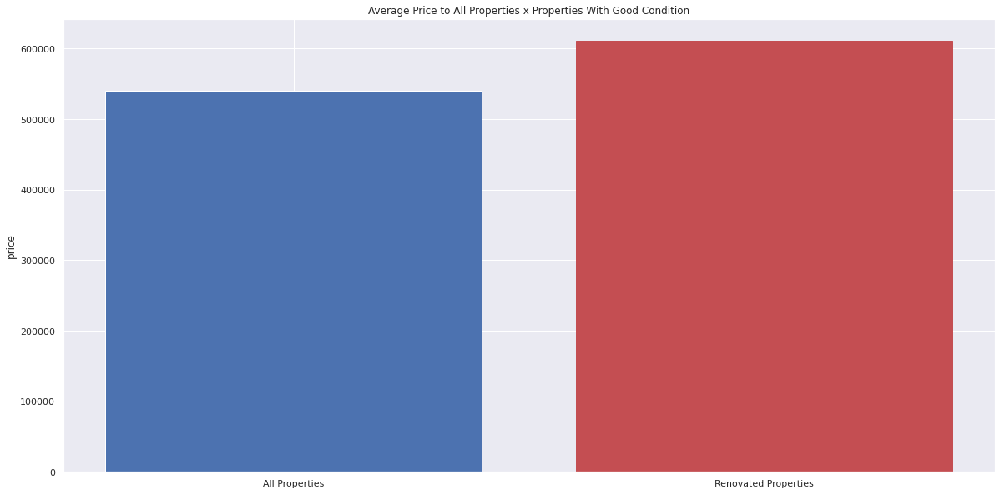

In [86]:
#H9: Properties in good condition are 15% or more expensive compared to the total average
dataMean = round(data['price'].mean(), 2)
print(f'The total price of dataset is US${dataMean}')

goodCondition = round(data['price'].loc[data['condition'] == 'good'].mean(), 2)
print(f'The total price for properties with good condition is US${goodCondition}')

rate5 = round(((goodCondition - dataMean) / dataMean * 100), 2)
print(f'Properties in good condition correspond to {rate5}% of the total property price')

grupos = ['All Properties', 'Renovated Properties']
valores = [dataMean, goodCondition]
barlist = plt.bar(grupos, valores)
barlist[1].set_color('r')
plt. title('Average Price to All Properties x Properties With Good Condition')
plt.ylabel('price')
plt.show()

The mean price the properties with less than 2 floors is US$460095.52
The mean price the properties with 2 floors or more is US$651905.32
Properties with 2 or more floors are 41.69% most expensive tha properties with less than 2 floors


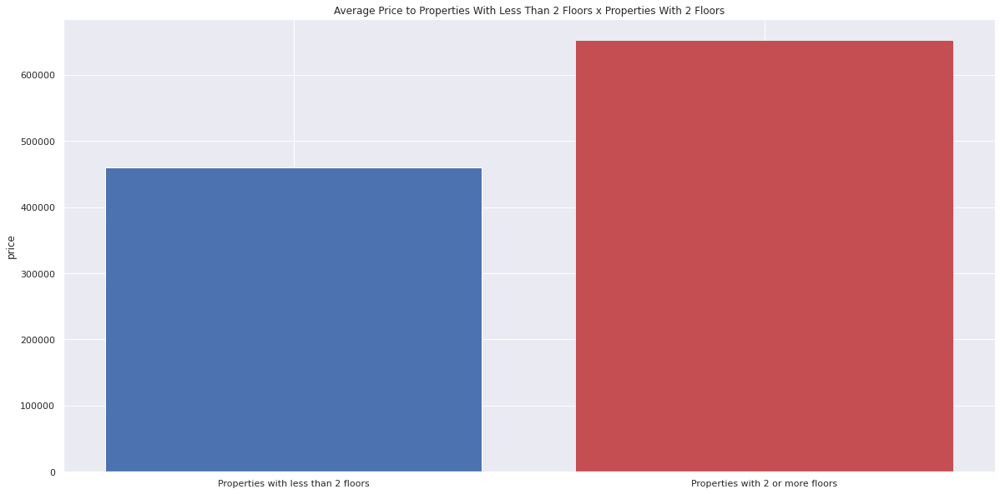

In [87]:
#H10: Properties with 2 or more floors are 15% most expensive than properties with less than 2 floors.
lessTwoFloors = round(data['price'].loc[data['floors'] < 2].mean(), 2)
print(f'The mean price the properties with less than 2 floors is US${lessTwoFloors}')

twoFloorsOrMore = round(data['price'].loc[data['floors'] >= 2].mean(), 2)
print(f'The mean price the properties with 2 floors or more is US${twoFloorsOrMore}')

rate6 = round((twoFloorsOrMore - lessTwoFloors) / lessTwoFloors * 100, 2)
print(f'Properties with 2 or more floors are {rate6}% most expensive tha properties with less than 2 floors')

grupos = ['Properties with less than 2 floors', 'Properties with 2 or more floors']
valores = [lessTwoFloors, twoFloorsOrMore]
barlist = plt.bar(grupos, valores)
barlist[1].set_color('r')
plt. title('Average Price to Properties With Less Than 2 Floors x Properties With 2 Floors')
plt.ylabel('price')
plt.show()